# Modelo de machine learning para detecção de fraude em transações com cartão de crédito

## Informações sobre o dataset
O conjunto de dados contém transações realizadas com cartões de crédito em <b>setembro de 2013</b> por titulares de cartões europeus.
Este conjunto de dados apresenta transações ocorridas em <b>dois dias</b>, onde temos <b>492 fraudes</b> em <b>284.807 transações</b>. O conjunto de dados é <b>altamente desequilibrado</b>, <b>a classe positiva (fraudes) representa 0,172% de todas as transações</b>.

Ele contém apenas variáveis ​​de entrada numéricas que são o resultado de uma <b>transformação PCA</b>. 

<ul>
    <li>As features <b>V1</b>, <b>V2</b>,… <b>V28</b> são os principais componentes obtidos com <b>PCA</b>.</li>
    <li>As únicas features que não foram transformados com PCA são <b>Time</b> e <b>Amount</b>. A feature <b>Time</b> contém os segundos decorridos entre cada transação e a primeira transação no conjunto de dados. A feature <b>Amount</b> é o valor da transação.</li>
    <li><b>Class</b> é a variável de resposta e assume valor 1 em caso de fraude e 0 caso contrário.</li>
</ul> 

## Carregando pacotes

In [1]:
import time
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import plotly.figure_factory as ff
import plotly.express as px
from plotly.offline import iplot

from sklearn.model_selection import train_test_split, GridSearchCV
import xgboost as xgb
from sklearn.ensemble import RandomForestClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.neighbors import KNeighborsClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import classification_report
from sklearn.model_selection import cross_val_score, StratifiedKFold
from sklearn.metrics import precision_recall_curve, average_precision_score
from sklearn.metrics import roc_auc_score

import warnings
warnings.filterwarnings('ignore')

pd.set_option('display.max_columns', None)

## Funções

In [2]:
# Função para atualizar dataset com o desempenho dos modelos
def atualiza_df_desempenho(modelo, desempenho_modelos, report_dict, auprc):
    desempenho_modelos.loc[modelo] = [np.nan] * len(desempenho_modelos.columns)
    desempenho_modelos.loc[modelo,'AUPRC'] = auprc
    desempenho_modelos.loc[modelo,'accuracy'] = report_dict['accuracy']
    for i in desempenho_modelos.columns[1:-1]:
        desempenho_modelos.loc[modelo,i] = report_dict['1'][i]
    return desempenho_modelos

## Leitura dos dados

In [3]:
df = pd.read_csv('creditcard.csv')

## Conhecendo o dataset

### Verificando o tamanho do dataset

In [4]:
df.shape

(284807, 31)

### Verificando as primeiras linhas do dataset

In [5]:
df.head(5)

,Time,V1,V2,V3,V4,V5,V6,V7,V8,V9,V10,V11,V12,V13,V14,V15,V16,V17,V18,V19,V20,V21,V22,V23,V24,V25,V26,V27,V28,Amount,Class
0,0.0,-1.359807,-0.072781,2.536347,1.378155,-0.338321,0.462388,0.239599,0.098698,0.363787,0.090794,-0.551600,-0.617801,-0.991390,-0.311169,1.468177,-0.470401,0.207971,0.025791,0.403993,0.251412,-0.018307,0.277838,-0.110474,0.066928,0.128539,-0.189115,0.133558,-0.021053,149.62,0
1,0.0,1.191857,0.266151,0.166480,0.448154,0.060018,-0.082361,-0.078803,0.085102,-0.255425,-0.166974,1.612727,1.065235,0.489095,-0.143772,0.635558,0.463917,-0.114805,-0.183361,-0.145783,-0.069083,-0.225775,-0.638672,0.101288,-0.339846,0.167170,0.125895,-0.008983,0.014724,2.69,0
2,1.0,-1.358354,-1.340163,1.773209,0.379780,-0.503198,1.800499,0.791461,0.247676,-1.514654,0.207643,0.624501,0.066084,0.717293,-0.165946,2.345865,-2.890083,1.109969,-0.121359,-2.261857,0.524980,0.247998,0.771679,0.909412,-0.689281,-0.327642,-0.139097,-0.055353,-0.059752,378.66,0
3,1.0,-0.966272,-0.185226,1.792993,-0.863291,-0.010309,1.247203,0.237609,0.377436,-1.387024,-0.054952,-0.226487,0.178228,0.507757,-0.287924,-0.631418,-1.059647,-0.684093,1.965775,-1.232622,-0.208038,-0.108300,0.005274,-0.190321,-1.175575,0.647376,-0.221929,0.062723,0.061458,123.50,0
4,2.0,-1.158233,0.877737,1.548718,0.403034,-0.407193,0.095921,0.592941,-0.270533,0.817739,0.753074,-0.822843,0.538196,1.345852,-1.119670,0.175121,-0.451449,-0.237033,-0.038195,0.803487,0.408542,-0.009431,0.798278,-0.137458,0.141267,-0.206010,0.502292,0.219422,0.215153,69.99,0


### Verificando as informações do dataset

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 284807 entries, 0 to 284806
Data columns (total 31 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   Time    284807 non-null  float64
 1   V1      284807 non-null  float64
 2   V2      284807 non-null  float64
 3   V3      284807 non-null  float64
 4   V4      284807 non-null  float64
 5   V5      284807 non-null  float64
 6   V6      284807 non-null  float64
 7   V7      284807 non-null  float64
 8   V8      284807 non-null  float64
 9   V9      284807 non-null  float64
 10  V10     284807 non-null  float64
 11  V11     284807 non-null  float64
 12  V12     284807 non-null  float64
 13  V13     284807 non-null  float64
 14  V14     284807 non-null  float64
 15  V15     284807 non-null  float64
 16  V16     284807 non-null  float64
 17  V17     284807 non-null  float64
 18  V18     284807 non-null  float64
 19  V19     284807 non-null  float64
 20  V20     284807 non-null  float64
 21  V21     28

### Verificando se existem valores missing

In [7]:
df.isnull().sum()

Time      0
V1        0
V2        0
V3        0
V4        0
V5        0
V6        0
V7        0
V8        0
V9        0
V10       0
V11       0
V12       0
V13       0
V14       0
V15       0
V16       0
V17       0
V18       0
V19       0
V20       0
V21       0
V22       0
V23       0
V24       0
V25       0
V26       0
V27       0
V28       0
Amount    0
Class     0
dtype: int64

## Análise Exploratória

### Transações ao longo do tempo

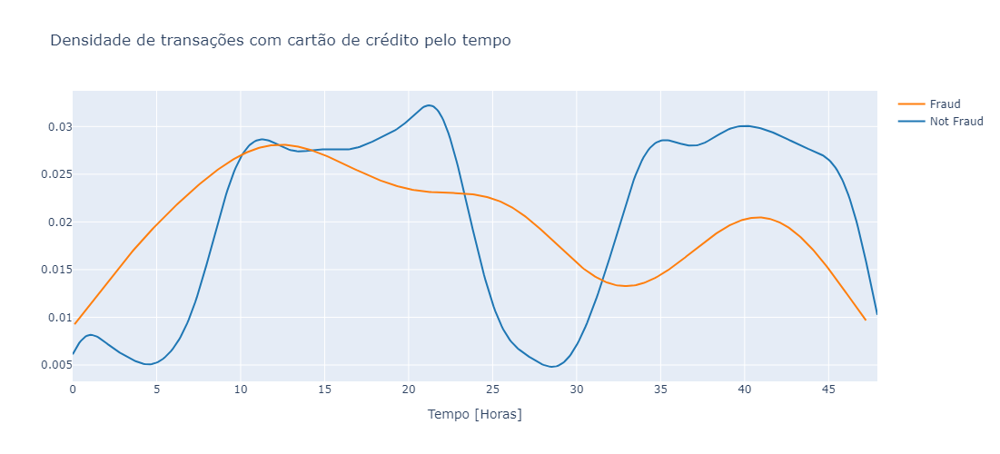

In [8]:
fraud_trans = df[df['Class'] == 1]['Time'] / 3600
valid_trans = df[df['Class'] == 0]['Time'] / 3600

hist_data = [valid_trans, fraud_trans]
group_labels = ['Not Fraud', 'Fraud']

fig = ff.create_distplot(hist_data, group_labels, show_hist=False, show_rug=False)

fig.update_layout(width=800, height=500)

fig.layout.update(title='Densidade de transações com cartão de crédito pelo tempo', xaxis=dict(title='Tempo [Horas]'))
iplot(fig, filename='densidade')

Os gráficos acima mostram que as transações apresentam compotametnos periódicos. Apesar de possuirmos poucos dados, podemos induzir que esse comportamento periódico possa fazer sentido, visto que é provavel que em alguns horários do dia aconteçam mais transações e em outros menos. 

Sabemos que os dados correspondem a dois dias de duração. Entretanto, podemos induzir, pelos gráficos, que mesmo que tenham 48 horas de duração, contemplam três dias. Para uma melhor compreensão e análise do comportamento das transações, iremos deslocar o gráfico à esquerda em 4,5 horas. Isso fará com que os ráficos sejam de apenas dois dias e então poderemos comparar melhor o comportamento destes.

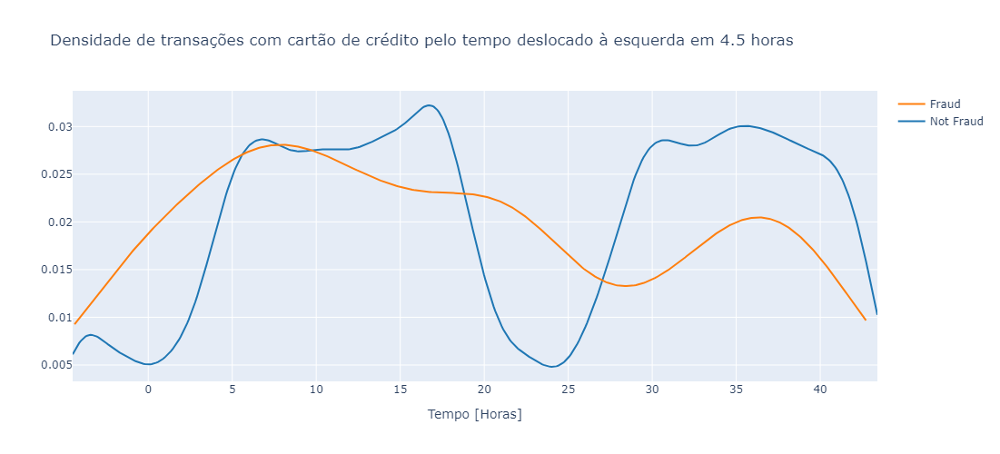

In [9]:
fraud_trans = df[df['Class'] == 1]['Time'] / 3600 - 4.5
valid_trans = df[df['Class'] == 0]['Time'] / 3600 - 4.5

hist_data = [valid_trans, fraud_trans]
group_labels = ['Not Fraud', 'Fraud']

fig = ff.create_distplot(hist_data, group_labels, show_hist=False, show_rug=False)

fig.update_layout(width=800, height=500)

fig.layout.update(title='Densidade de transações com cartão de crédito pelo tempo deslocado à esquerda em 4.5 horas', xaxis=dict(title='Tempo [Horas]'))
iplot(fig, filename='densidade')

Nota-se que o comportamento das transações se repete acada 24 horas, confirmando a periodicidade.

### Valores de transações ao longo do tempo

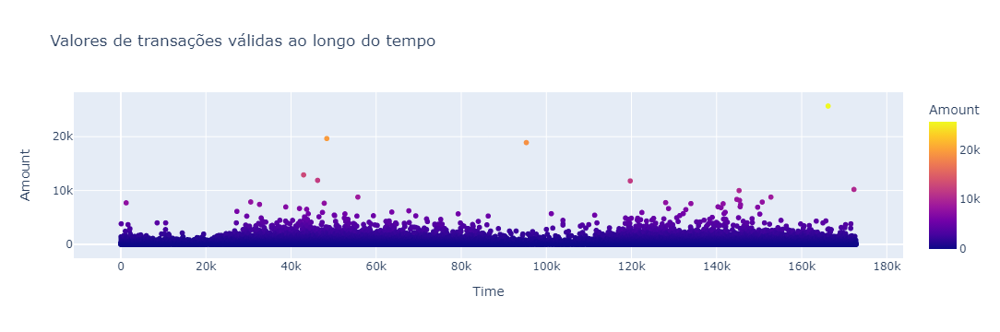

In [10]:
fig = px.scatter(df[df['Class'] == 0], x='Time', y='Amount', color='Amount', title='Valores de transações válidas ao longo do tempo')

fig.update_traces(selector=dict(name='B'))

fig.show()

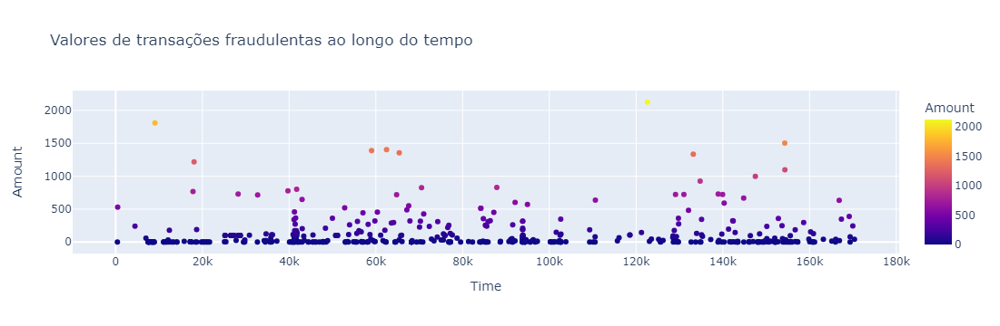

In [11]:
fig = px.scatter(df[df['Class'] == 1], x='Time', y='Amount', color='Amount', title='Valores de transações fraudulentas ao longo do tempo')

fig.update_traces(selector=dict(name='B'))

fig.show()

Nota-se que as transações fraudulentas apresentam valores mais baixos em relação às transações válidas.

### Distribuição de frequências dos valores das transferências

Text(0.5, 1.0, 'Distribuição de frequências do montante de transações válidas')

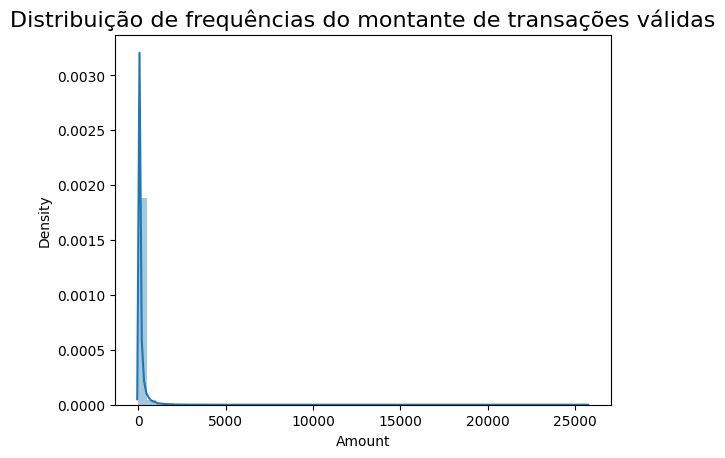

In [12]:
ax = sns.distplot(df[df['Class'] == 0]['Amount'], kde=True)
ax.set_title('Distribuição de frequências do montante de transações válidas', fontsize=16)

Text(0.5, 1.0, 'Distribuição de frequências do montante de transações fraudulentas')

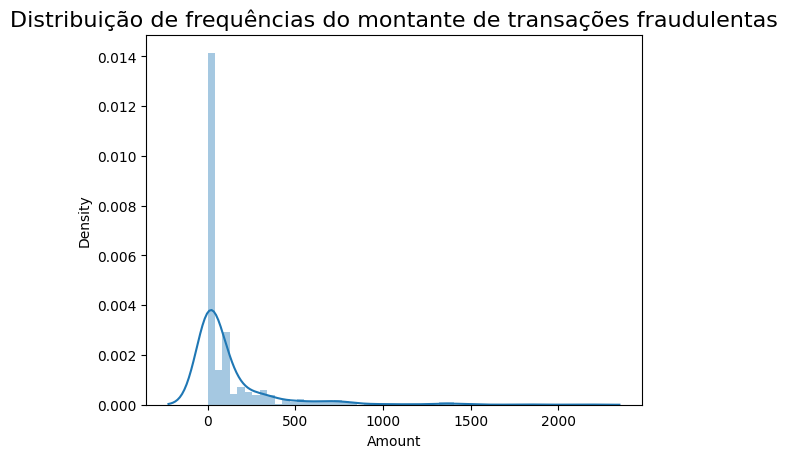

In [13]:
ax = sns.distplot(df[df['Class'] == 1]['Amount'], kde=True)
ax.set_title('Distribuição de frequências do montante de transações fraudulentas', fontsize=16)

### Boxplot da variável Amount

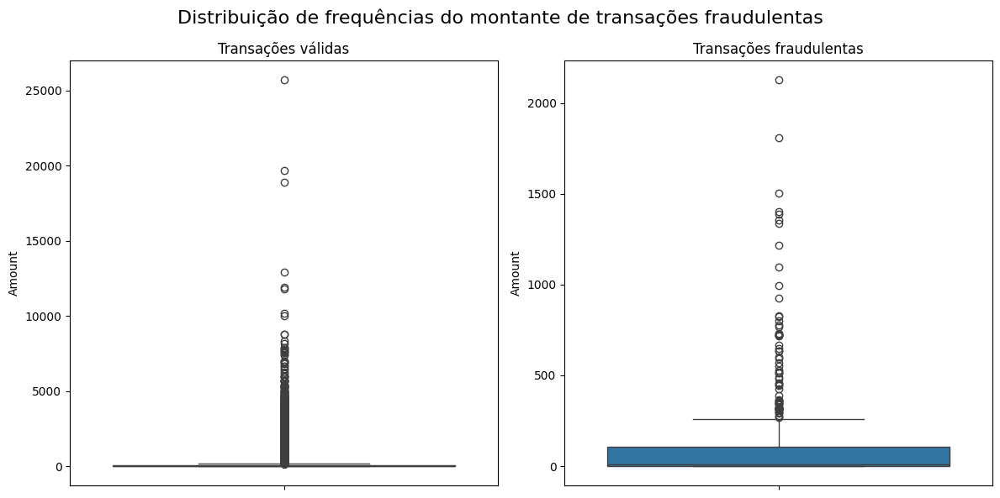

In [14]:
fig,axes =  plt.subplots(1,2, figsize=(12,6))

ax = sns.boxplot(df[df['Class'] == 0], y='Amount', ax=axes[0])
axes[0].set_title('Transações válidas', fontsize=12)

sns.boxplot(df[df['Class'] == 1], y='Amount', ax=axes[1])
axes[1].set_title('Transações fraudulentas', fontsize=12)
             
fig.suptitle('Distribuição de frequências do montante de transações fraudulentas', fontsize=16)
plt.tight_layout()
plt.show()

Os gráficos nos induzem a confirmar que as transações fraudulentas realmente apresentam valores menores do que as válidas. Entretanto, pela grande presença de possíveis outliers, os gráficos ficam difíceis de serem analisados. 

Abaixo, iremos verificar as estatísticas das variáveis. Isso nos ajudará a analisar melhor.

### Estatísticas descritivas

In [15]:
print('Amount para transações Válidas:')
print(df[df['Class'] == 0]['Amount'].describe().round(), '\n')

print('Amount para transações fraudulentas:')
print(df[df['Class'] == 1]['Amount'].describe().round())

Amount para transações Válidas:
count    284315.0
mean         88.0
std         250.0
min           0.0
25%           6.0
50%          22.0
75%          77.0
max       25691.0
Name: Amount, dtype: float64 

Amount para transações fraudulentas:
count     492.0
mean      122.0
std       257.0
min         0.0
25%         1.0
50%         9.0
75%       106.0
max      2126.0
Name: Amount, dtype: float64


Observando as estatísticas da variável, não podemos concluir se as transações fraudulentas apresentam valores menores que as válidas. Um tipo de apresenta édia maior, o outro apresenta mediana maior.

### Balanceamento da variável target

In [16]:
df['Class'].value_counts()

Class
0    284315
1       492
Name: count, dtype: int64

A variável é muito desbalanceada. Iremos balancea-la mais adiante.

### Correlação entre as variáveis

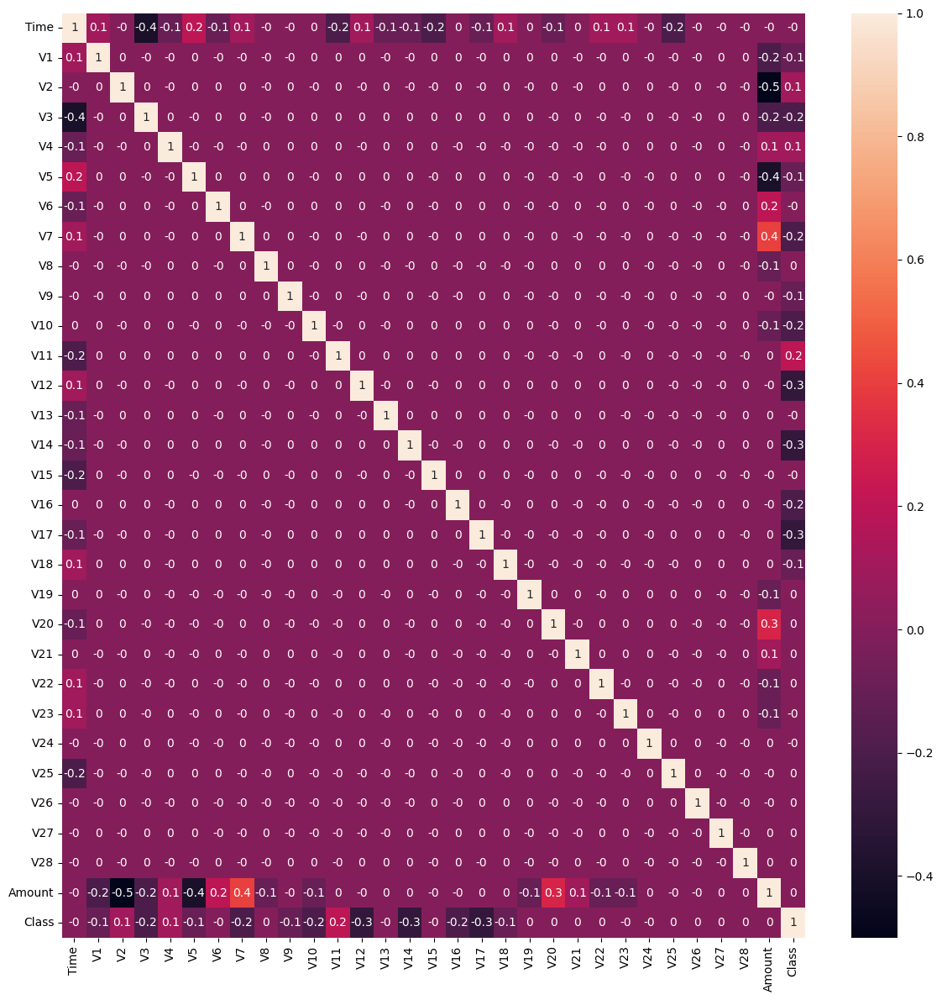

In [17]:
plt.figure(figsize=(12,12))
sns.heatmap(df.corr().round(1), annot=True)

plt.tight_layout()
plt.show()

As variáveis de <b>V1</b> a <b>V28</b> não apresentam correlação entre si, como já era de se esperar. A variável <b>Time</b> apresenta correlação negativa com a variável <b>V3</b> e a variável <b>Amount</b> apresenta correlação negativa com <b>V2</b> e <b>V5</b>, e correlação positiva com <b>V7</b> e <b>V20</b>.

#### Correlação entre Time e V3

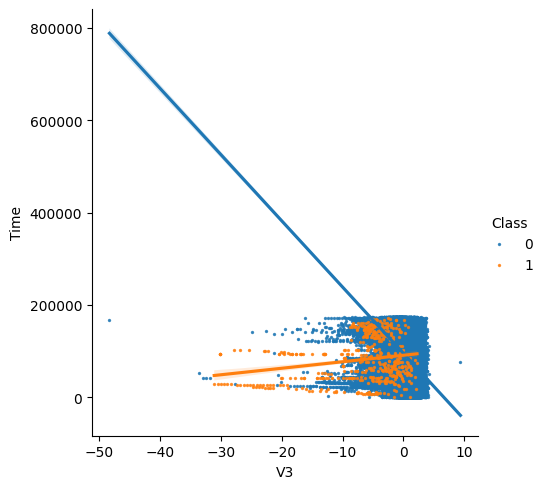

In [18]:
sns.lmplot(df, hue='Class', x='V3', y='Time', fit_reg=True, scatter_kws={'s':2})

As correlações são diferentes para transações fraudulentas e válidas. As fraudulentas apresentam correlação positiva, enquanto as válidas apresentam correlação negativa.

#### Correlação entre as variaveis Amount e V2, V5, V7 e V20

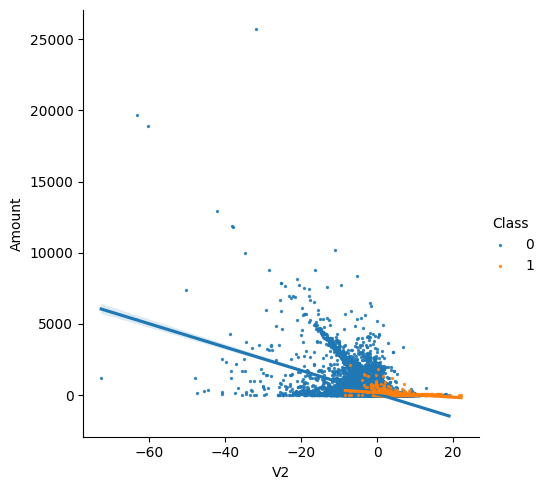

In [19]:
sns.lmplot(df, hue='Class', y='Amount', x='V2', fit_reg=True, scatter_kws={'s':2})

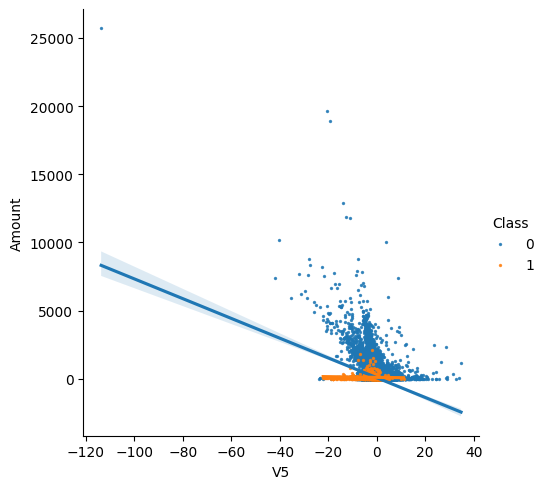

In [20]:
sns.lmplot(df, hue='Class', y='Amount', x='V5', fit_reg=True, scatter_kws={'s':2})

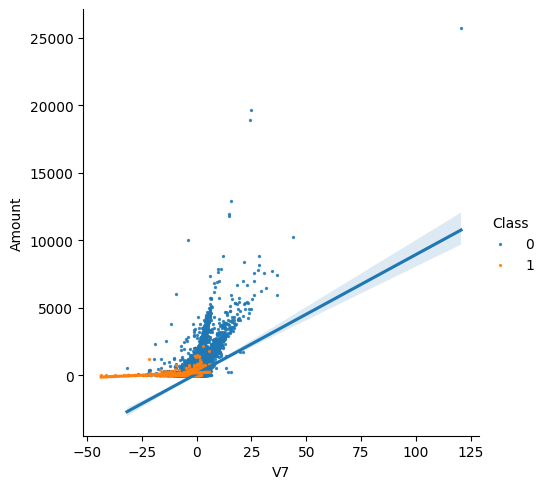

In [21]:
sns.lmplot(df, hue='Class', y='Amount', x='V7', fit_reg=True, scatter_kws={'s':2})

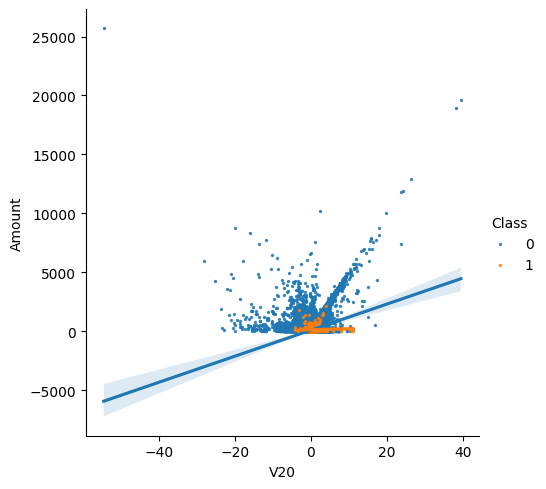

In [22]:
sns.lmplot(df, hue='Class', y='Amount', x='V20', fit_reg=True, scatter_kws={'s':2})

Nota-se que o grau de inclinação das retas de regressão é muito mais acentuado para transações válidas do que para fraudulentas. Estas últimas apresentam correlações mais flat.

### Distribuições de frequencia das variáveis 

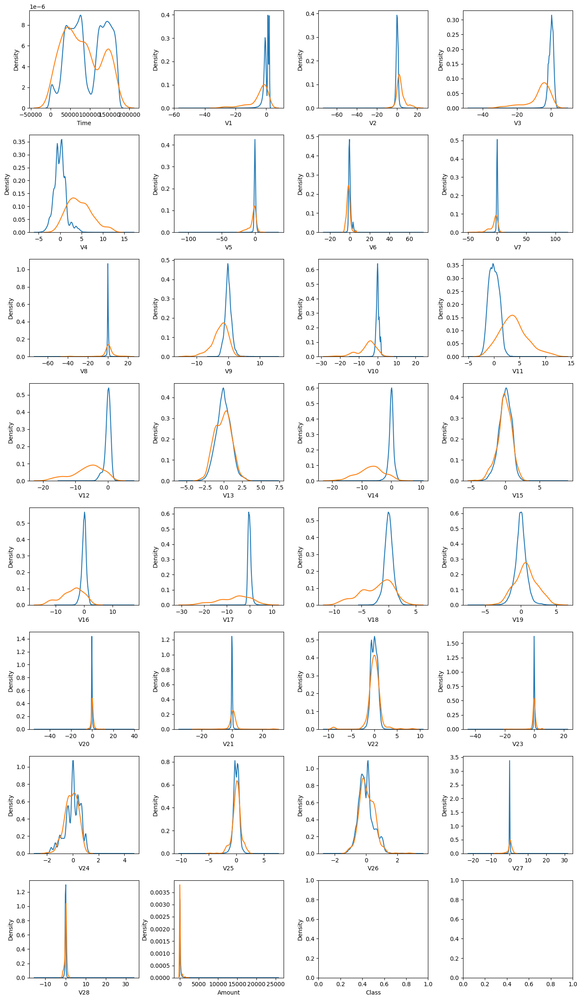

In [23]:
_,axes = plt.subplots(8,4,figsize=(14,24))

line = 0
col = 0

for i in df.columns:
    sns.kdeplot(df[df['Class'] == 0][i], ax=axes[line,col])
    sns.kdeplot(df[df['Class'] == 1][i], ax=axes[line,col])
    col+=1
    if col > 3:
        col = 0
        line+=1

plt.tight_layout()
plt.show()

Podemos notar que algumas variáveis apresentam muita distinção entre as classes válida e fraudulenta, como <b>V3</b>, <b>V4</b>, <b>V10</b>, <b>V11</b>, <b>V12</b> e <b>V14</b>. Essas variáveis podem ser muito determinantes para o modelo.

## Criação de modelos

### Dividindo dataset em treino e teste

In [24]:
X = df.drop('Class', axis=1)
y = df['Class']

In [25]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=.3, random_state=42)

### Normalizando os dados

In [26]:
normalizador = MinMaxScaler()
X_train = normalizador.fit_transform(X_train)
X_test = normalizador.transform(X_test)

### Random Forest

In [27]:
randomforest = RandomForestClassifier(n_jobs=-1, random_state=42)

In [28]:
randomforest.fit(X_train, y_train)

RandomForestClassifier(n_jobs=-1, random_state=42)

In [29]:
y_pred = randomforest.predict(X_test)

#### Ranking de importância das variáveis

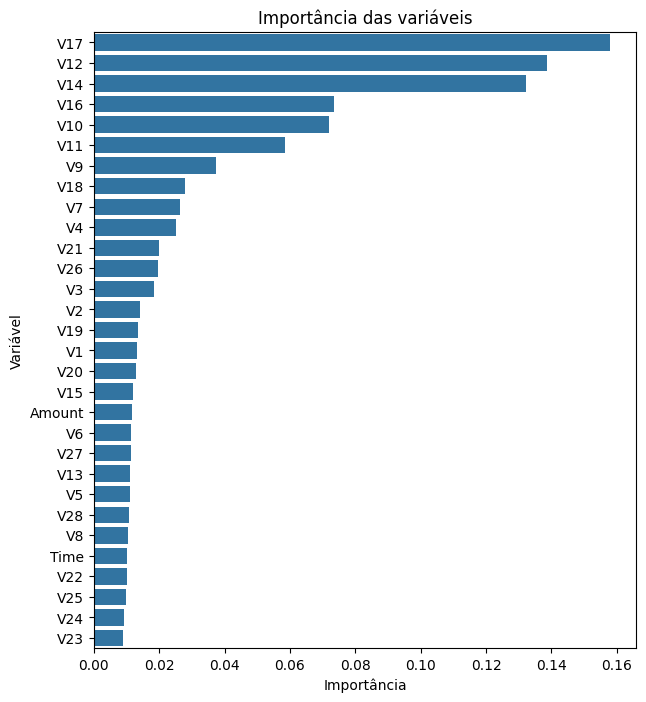

In [30]:
vars = pd.DataFrame({'Variável': X.columns, 'Importância': randomforest.feature_importances_})
vars.sort_values(by='Importância', ascending=False, inplace=True)

plt.figure(figsize=(7,8))
plt.title('Importância das variáveis')

ax = sns.barplot(vars, y='Variável', x='Importância')
plt.show()

#### Matriz de confusão

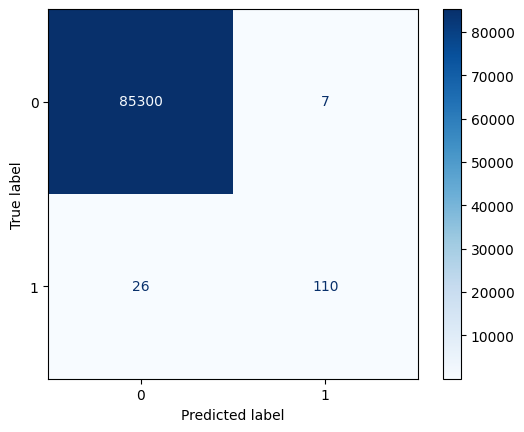

In [31]:
cm = confusion_matrix(y_test,y_pred)
cm_disp = ConfusionMatrixDisplay(cm)
cm_disp.plot(include_values=True, cmap='Blues')

#### Precision, Recall e f1-score

In [32]:
report_dict = classification_report(y_test, y_pred, output_dict=True)
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     85307
           1       0.94      0.81      0.87       136

    accuracy                           1.00     85443
   macro avg       0.97      0.90      0.93     85443
weighted avg       1.00      1.00      1.00     85443



O modelo apresentou bom resultado. A métrica mais relevante para o noso tipo de aplicação seria o Recall, que resultou em 80%. Entretanto, como a variável target é muito desbalanceada, essas métricas não são muito indicadas. Iremos avaliar a **Precision-Recall Curve**, que mostra a relação entre precisão e recall.

#### Precision-Recall Curve (AUPRC)

In [33]:
auprc = average_precision_score(y_test, y_pred)
print(f'AUPRC: {auprc:.4f}')

AUPRC: 0.7607


#### Criando dataframe para armazenar o desempenho dos modelos

In [34]:
metricas = ['AUPRC', 'precision', 'recall', 'f1-score', 'accuracy']

desempenho_modelos = pd.DataFrame(columns=metricas)

In [35]:
desempenho_modelos = atualiza_df_desempenho('Random Forest', desempenho_modelos, report_dict, auprc)
desempenho_modelos

,AUPRC,precision,recall,f1-score,accuracy
Random Forest,0.760737,0.940171,0.808824,0.869565,0.999614


### XGBoost

In [36]:
clf = xgb.XGBClassifier(n_jobs=-1, 
                        random_state=42)

In [37]:
clf.fit(X_train, y_train)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric=None, feature_types=None,
              gamma=None, grow_policy=None, importance_type=None,
              interaction_constraints=None, learning_rate=None, max_bin=None,
              max_cat_threshold=None, max_cat_to_onehot=None,
              max_delta_step=None, max_depth=None, max_leaves=None,
              min_child_weight=None, missing=nan, monotone_constraints=None,
              multi_strategy=None, n_estimators=None, n_jobs=-1,
              num_parallel_tree=None, random_state=42, ...)

In [38]:
y_pred = clf.predict(X_test)

#### Ranking de importância das variáveis

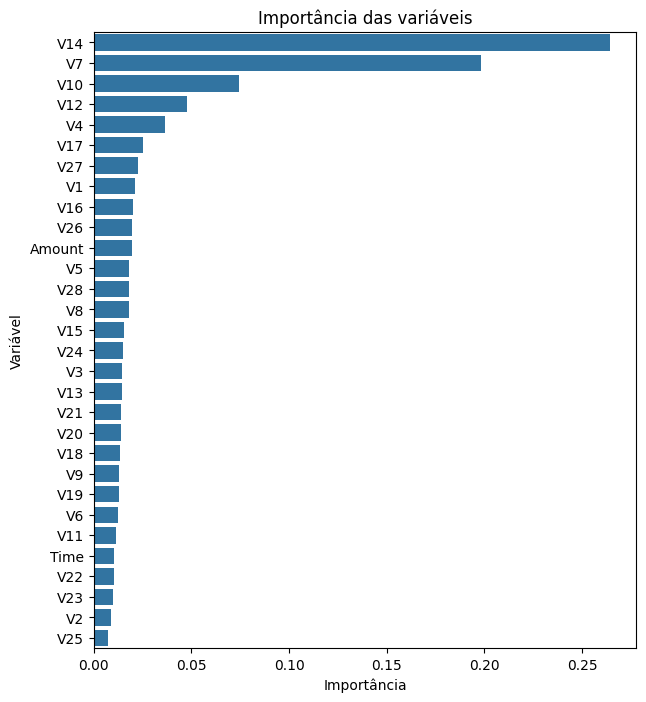

In [39]:
vars = pd.DataFrame({'Variável': X.columns, 'Importância': clf.feature_importances_})
vars.sort_values(by='Importância', ascending=False, inplace=True)

plt.figure(figsize=(7,8))
plt.title('Importância das variáveis')

ax = sns.barplot(vars, y='Variável', x='Importância')
plt.show()

#### Matriz de confusão

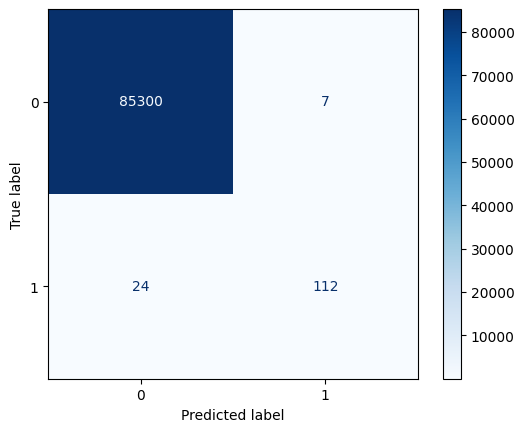

In [40]:
cm = confusion_matrix(y_test,y_pred)
cm_disp = ConfusionMatrixDisplay(cm)
cm_disp.plot(include_values=True, cmap='Blues')

#### Precision, Recall e f1-score

In [41]:
report_dict = classification_report(y_test, y_pred, output_dict=True)
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     85307
           1       0.94      0.82      0.88       136

    accuracy                           1.00     85443
   macro avg       0.97      0.91      0.94     85443
weighted avg       1.00      1.00      1.00     85443



#### Precision-Recall Curve (AUPRC)

In [42]:
auprc = average_precision_score(y_test, y_pred)
print(f'AUPRC para modelo XGBoost: {auprc:.4f}')

AUPRC para modelo XGBoost: 0.7754


In [43]:
desempenho_modelos = atualiza_df_desempenho('XGBoost', desempenho_modelos, report_dict, auprc)
desempenho_modelos

,AUPRC,precision,recall,f1-score,accuracy
Random Forest,0.760737,0.940171,0.808824,0.869565,0.999614
XGBoost,0.775367,0.941176,0.823529,0.878431,0.999637


Podemos notar que o modelo XGBoost apresentou resultado um pouco melhor que o modelo Random Forest.

### Regressão logística

In [44]:
clf = LogisticRegression(n_jobs=-1, random_state=42)

In [45]:
inicio = time.time()
clf.fit(X_train, y_train)
fim = time.time()

In [46]:
y_pred = clf.predict(X_test)

#### Matriz de confusão

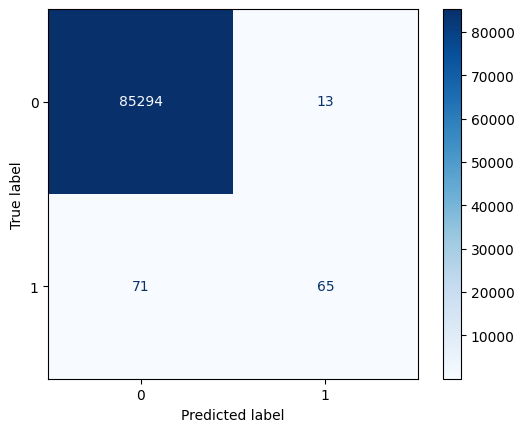

In [47]:
cm = confusion_matrix(y_test,y_pred)
cm_disp = ConfusionMatrixDisplay(cm)
cm_disp.plot(include_values=True, cmap='Blues')

#### Precision, Recall e f1-score

In [48]:
report_dict = classification_report(y_test, y_pred, output_dict=True)
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     85307
           1       0.83      0.48      0.61       136

    accuracy                           1.00     85443
   macro avg       0.92      0.74      0.80     85443
weighted avg       1.00      1.00      1.00     85443



#### Precision-Recall Curve (AUPRC)

In [49]:
auprc = average_precision_score(y_test, y_pred)
print(f'AUPRC para modelo XGBoost: {auprc:.4f}')

AUPRC para modelo XGBoost: 0.3991


In [50]:
desempenho_modelos = atualiza_df_desempenho('Regressão Logística', desempenho_modelos, report_dict, auprc)
desempenho_modelos

,AUPRC,precision,recall,f1-score,accuracy
Random Forest,0.760737,0.940171,0.808824,0.869565,0.999614
XGBoost,0.775367,0.941176,0.823529,0.878431,0.999637
Regressão Logística,0.399115,0.833333,0.477941,0.607477,0.999017


O desempenho do modelo Regressão Logística foi o pior de todos, até o momento.

### KNN

In [51]:
clf = KNeighborsClassifier(n_jobs=-1, metric='euclidean')

In [52]:
inicio = time.time()
clf.fit(X_train, y_train)
fim = time.time()

In [53]:
y_pred = clf.predict(X_test)

#### Matriz de confusão

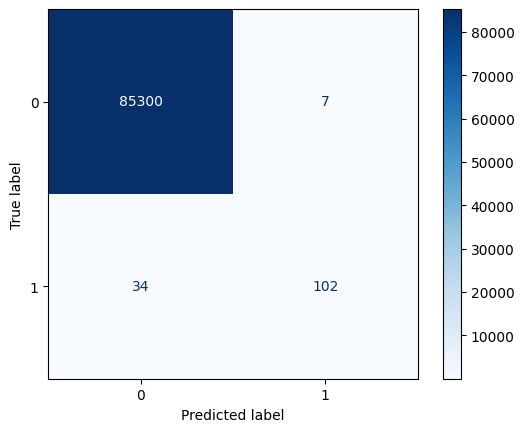

In [54]:
cm = confusion_matrix(y_test,y_pred)
cm_disp = ConfusionMatrixDisplay(cm)
cm_disp.plot(include_values=True, cmap='Blues')

#### Precision, Recall e f1-score

In [55]:
report_dict = classification_report(y_test, y_pred, output_dict=True)
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     85307
           1       0.94      0.75      0.83       136

    accuracy                           1.00     85443
   macro avg       0.97      0.87      0.92     85443
weighted avg       1.00      1.00      1.00     85443



#### Precision-Recall Curve (AUPRC)

In [56]:
auprc = average_precision_score(y_test, y_pred)
print(f'AUPRC para modelo XGBoost: {auprc:.4f}')

AUPRC para modelo XGBoost: 0.7022


In [57]:
desempenho_modelos = atualiza_df_desempenho('KNN', desempenho_modelos, report_dict, auprc)
desempenho_modelos

,AUPRC,precision,recall,f1-score,accuracy
Random Forest,0.760737,0.940171,0.808824,0.869565,0.999614
XGBoost,0.775367,0.941176,0.823529,0.878431,0.999637
Regressão Logística,0.399115,0.833333,0.477941,0.607477,0.999017
KNN,0.702233,0.935780,0.750000,0.832653,0.999520


O modelo KNN apresentou bom resultado, mas não foi o melhor.

### Árvore de Decisão

In [58]:
clf = DecisionTreeClassifier(random_state=42)

In [59]:
inicio = time.time()
randomforest.fit(X_train, y_train)
fim = time.time()

In [60]:
y_pred = randomforest.predict(X_test)

#### Ranking de importância das variáveis

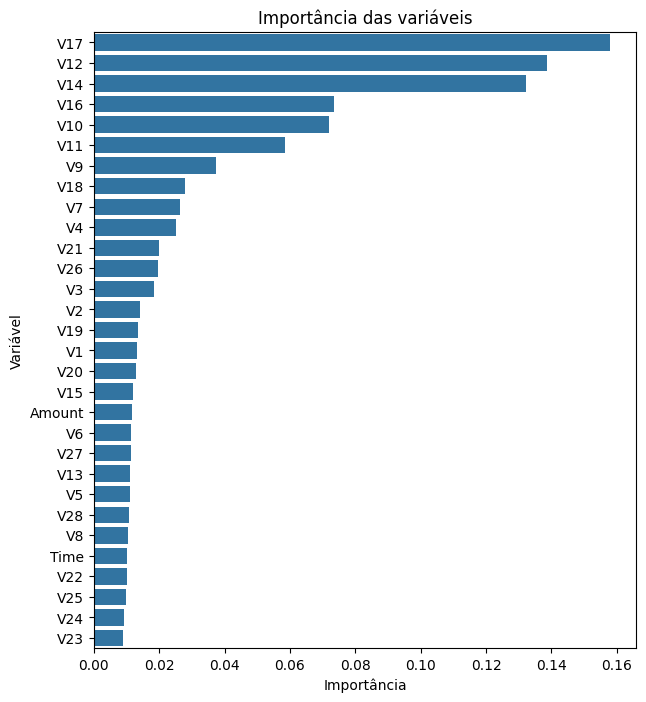

In [61]:
vars = pd.DataFrame({'Variável': X.columns, 'Importância': randomforest.feature_importances_})
vars.sort_values(by='Importância', ascending=False, inplace=True)

plt.figure(figsize=(7,8))
plt.title('Importância das variáveis')

ax = sns.barplot(vars, y='Variável', x='Importância')
plt.show()

#### Matriz de confusão

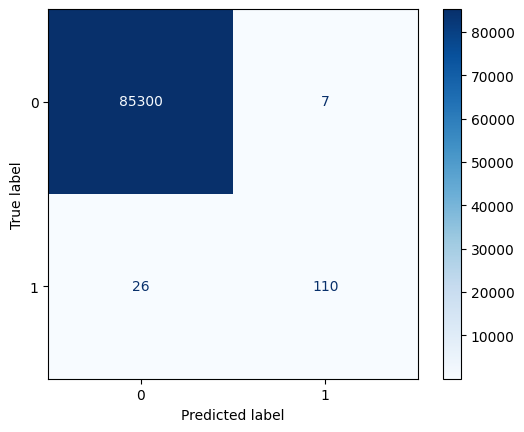

In [62]:
cm = confusion_matrix(y_test,y_pred)
cm_disp = ConfusionMatrixDisplay(cm)
cm_disp.plot(include_values=True, cmap='Blues')

#### Precision, Recall e f1-score

In [63]:
report_dict = classification_report(y_test, y_pred, output_dict=True)
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00     85307
           1       0.94      0.81      0.87       136

    accuracy                           1.00     85443
   macro avg       0.97      0.90      0.93     85443
weighted avg       1.00      1.00      1.00     85443



#### Precision-Recall Curve (AUPRC)

In [64]:
auprc = average_precision_score(y_test, y_pred)
print(f'AUPRC: {auprc:.4f}')

AUPRC: 0.7607


#### Criando dataframe para armazenar o desempenho dos modelos

In [65]:
desempenho_modelos = atualiza_df_desempenho('Árvore de Decisão', desempenho_modelos, report_dict, auprc)
desempenho_modelos

,AUPRC,precision,recall,f1-score,accuracy
Random Forest,0.760737,0.940171,0.808824,0.869565,0.999614
XGBoost,0.775367,0.941176,0.823529,0.878431,0.999637
Regressão Logística,0.399115,0.833333,0.477941,0.607477,0.999017
KNN,0.702233,0.935780,0.750000,0.832653,0.999520
Árvore de Decisão,0.760737,0.940171,0.808824,0.869565,0.999614


O modelo XGBoost manteve-se como o melhor em termos de desempenho. Esse será o modelo escolhido.

## Conclusões

Ao longo do desenvolvimento do projeto, foi possível analisar as variáveis, familiarizar-se com seus comportamentos e verificar suas correlações entre si. Observou-se que o comportamento das transações ao longo do tempo apresentaram uma estrutura periódica dos dados.

Um dificultador para os modelos foi o grande desbalanceamento da variável target, que é natural para problemas de detecção de fraude. Esse desbalanceamente se deu pelo baixo percentual de transações fraudulentas, 0,172%.

Foram feitas comparações de desempenho entre cinco modelos, com diferentes abordagens, **Random Forest**, **XGBoost**, **Regressão Logística**, **KNN**, **Árvore de Decisão**. Ao final, elegeu-se o melhor modelo.

O modelo **Random Forest** obteve **área abaixo de precisão-recall (AUPRC)** de **0.761** para dados de teste.

O modelo **XGBoost**, apresentou o melhor desempenho de todos os modelos para dados de teste. Obteve AUPRC de **0.775**.

O modelo **Regressão Logística** apresentou o pior resultado de todos. Obteve AUPRC de **0.399** para dados de teste.

O modelo **KNN** obteve AUPRC de **0.702** para dados de teste.

O modelo **Árvore de Decisão** obteve AUPRC de **0.761** para dados de teste.